In [ ]:
!pip install missingno

### **Metodologia CRISP - DM**

O projeto utilizou-se da metodologia **CRISP-DM** (Cross Industry Process Model for Data Mining) adaptada para projetos em Data Science - DS (Análise Exploratória de Dados, Machine Learning, Deep Learning, dentre outras aplicações). A referida metodologia baseia-se em 06 (seis) etapas, a saber: Entendimento do Negócio, Entendimento dos Dados,  Preparação dos Dados, Construção dos Modelos, Avaliação e Implementação.

<img alt="Colaboratory logo" width="75%" src="https://raw.githubusercontent.com/consultantleonardoferreira/Projetos-em-Data-Science/master/crisphorizontal.png">

**A. Entendendo o Negócio:** 

Nesta etapa serão estudados os objetivos do negócio, avaliada a situação negócio (quais problemas a serem resolvidos?), bem como determinado as metas e ou objetivos para o projeto de Data Science (quais objetivos e métricas de sucesso?)

**A1. Objetivos do Negócio.**

O [Airbnb](https://www.airbnb.com.br/) começou em 2008, quando dois designers que tinham um espaço sobrando hospedaram três viajantes que procuravam um lugar para ficar. Agora, milhões de anfitriões e viajantes optam por criar uma conta gratuita no Airbnb para que possam anunciar seu espaço e reservar acomodações únicas em qualquer lugar do mundo. Além disso, os anfitriões de experiências do Airbnb compartilham suas paixões e interesses com viajantes e moradores locais.

Os sites Digital Marketing Ramblings, Much Needed e Property Management oferecem alguns fatos interessantes sobre a empresa, com base em dados de **outubro de 2019** que serão adotados como baseline do projeto.

* Tóquio, Paris e Nova Iorque são as cidades mais populares em experiências de reserva no Airbnb.

* Desde 2017, houve um aumento de 120% no número de anfitriões seniores com mais de 60 anos.

* O ticket médio mundial de reservas por noite é de US$ 80, com média de 3 locais cadastrados por anfitrião.

* Mulheres com mais de 60 anos têm as classificações mais altas como anfitriãs na plataforma.

* 54% dos hóspedes são do gênero feminino. 

* 88% das reservas são feitas para grupos de duas a quatro pessoas, e 60% delas ocorrem em casas ou apartamentos inteiros.

* A palavra “air” (ar, em inglês) no título do Airbnb, surgiu após Brian Chesky (um dos fundadores da empresa) e seus colegas de quarto terem colocado um colchão de ar no chão da sala para alugar.

* Mais de 120 mil hóspedes já alugaram noites em castelos através da empresa;

* As cidades cuja demanda mais cresceu em 2019 foram Gangneung, na Coréia do Sul, Bournemouth, no Reino Unido, e Edmonton, no Canadá.

* O número projetado de usuários do Airbnb na Europa, até 2020, é de 24 milhões.

* No momento, quase 2 milhões de locais podem ser reservados instantaneamente.

* Mais de U$ 23,5 milhões foram gastos em propaganda somente nos EUA.
São mais de 191 países registrados na plataforma.


* A cidade brasileira cuja procura mais cresceu foi a praia de Matinhos, no Paraná.

* O Brasil é o 13º maior mercado do Airbnb no mundo.

* Representou um impacto de US$ 2,1 bilhões na economia do Brasil em 2018.

<center><img alt="Analisando Airbnb" width="30%" src="https://www.area360.com.au/wp-content/uploads/2017/09/airbnb-logo.jpg"></center>

**A2. Quais os problemas a serem resolvidos?**

No presente projeto busca-se resolver os seguintes problemas identificados pelo contratante do projeto:

* Quais os principais tipos de imóveis locados em Boston?
* Quais os bairros com maior custo de locação na cidade em Boston?
* Qual o custo médio de locação das unidades na cidade em Boston?
* Qual a quantidade média de diárias por locação na cidade em Boston?
* Qual a disponibidade médias dos imóveis na cidade em Boston?

**A3. Quais as métricas para aferição do sucesso do projeto de DS?**

* Respostas para as 5 (cinco) situações problemas apresentadas no item A2 considerando os dados disponibilizados pelo contratante, bem como integração com novas bases de dados a serem utilizadas na busca da solução dos problemas.

### **B. Entendendo os Dados:**

Nesta etapa estaremos coletando os dados iniciais, descrevendo os referidos dados, bem como explorando os dados com as estatísticas descritivas e por fim, verificando a qualidade de dados.


##### **B1.Coletando os dados iniciais**

Por meio do portal [Inside Airbnb](http://insideairbnb.com/get-the-data.html), é possível baixar uma grande quantidade de dados para desenvolver projetos e soluções em Data Science.

Dessa forma, foi selecionado o arquivo (listings.csv) - Summary information and metrics for listings in Boston. 

In [ ]:
# Carregando os pacotes do Python necessários à execução do Projeto de Data Science.

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import missingno
matplotlib.rcParams['font.size'] = 18
sns.set_context('talk', font_scale=1.2);
%matplotlib inline

In [ ]:
# Carregando o dataset com informações da plataforma Airbnb.

df = pd.read_csv("http://data.insideairbnb.com/united-states/ma/boston/2021-12-17/visualisations/listings.csv")

##### **B2. Descrevendo os dados**

Nessa etapa os dados são descritos com objetivo de conhecermos seu formato, os tipos de variáveis (numéricas ou categóricas), bem como aspectos gerais úteis ao entendimento geral do problema.



In [ ]:
# Conhecendo o formato do dataset.

df.shape

(3349, 18)

Em uma análise inicial percebe-se que o dataset apresenta um total de **3349** linhas, entradas ou observações, bem como um total de **18** colunas, variáveis ou features. Sendo interessante a construção de um dicionário com o significado das variáveis para melhor compreensão do problema geral. Adicionalmente, é bastante interessante verificarmos os tipos das variáveis que integram nosso dataset: inteiras, float, objetos. Tal análise poderá indicar na fase de preparação dos dados a necessidade de transformações para melhor aplicação de técnicas de Data Science.

In [ ]:
# Conhecendo as varíaveis e seus tipos.

display(df.dtypes)

id                                  int64
name                               object
host_id                             int64
host_name                          object
neighbourhood_group               float64
neighbourhood                      object
latitude                          float64
longitude                         float64
room_type                          object
price                               int64
minimum_nights                      int64
number_of_reviews                   int64
last_review                        object
reviews_per_month                 float64
calculated_host_listings_count      int64
availability_365                    int64
number_of_reviews_ltm               int64
license                            object
dtype: object

**Dicionário das variáveis**

* `id` - número de id gerado para identificar o imóvel.
* `name` - nome da propriedade anunciada.
* `host_id` - número de id do proprietário (anfitrião) da propriedade.
* `host_name` - Nome do anfitrião.
* `neighbourhood_group` - esta coluna não contém nenhum valor válido.
* `neighbourhood` - nome do bairro.
* `latitude` - coordenada da latitude da propriedade.
* `longitude` - coordenada da longitude da propriedade.
* `room_type` - informa o tipo de quarto que é oferecido.
* `price` - preço para alugar o imóvel.
* `minimum_nights` - quantidade mínima de noites para reservar.
* `number_of_reviews` - número de reviews que a propriedade possui.
* `last_review` - data do último review.
* `reviews_per_month` - quantidade de reviews por mês.
* `calculated_host_listings_count` - quantidade de imóveis do mesmo anfitrião.
* `availability_365` - número de dias de disponibilidade dentro de 365 dias.
* `license` - mostra a licensa pedida em alguns lugares para locação.

E por fim, nesta etapa, é interessante visualizarmos a estrutura do nosso dataset com suas linhas e colunas dispostos em forma tabular (Data Frame) com a possibilidade de identificação prematura de dados faltantes, possíveis valores discrepantes, dentre outras questões. **É o primeiro contato com o dataset!**

In [ ]:
# Comando para visualizarmos as 5 primeiras linhas do Dataset.

df.head(20)


In [ ]:
df.describe()

In [ ]:
# Comando para visualizarmos as 5 últimas linhas do Dataset.

df.tail()

##### **B3.Estatísticas Descritivas**

Agora que já conhecemos a estrutura de nossos dados, passamos para etapa de identificação da qualidade de nossos dados, por meio da aplicação de técnicas de estatística descritiva, com especial atenção para identificação de valores faltantes, presença de outliers, análise de correlações entre as variáveis, dentre outras questões relevantes nesta fase inicial.

In [ ]:
# Cálculo do percentual de dados faltantes no Dataset.

(df.isnull().sum() / df.shape[0]).sort_values(ascending=False)

**Quanto à questão de dados faltantes, em uma breve verificação podemos identificar que:**

* A coluna **`neighbourhood_group`** possui 100% dos seus valores faltantes. 
* A coluna **`license`** possui 45% dos seus valores faltantes.
* As variáveis**`reviews_per_month`** e **`last_review`** possuem valores nulos em quase 30% das linhas.
* A coluna **`host_name`** têm aproximadamente 10% dos valores nulos.


In [ ]:
for col in df.columns:
  perc=np.mean(df[col].isna())
  print(f'{col}: {round(perc*100)} %')

In [ ]:
plot = missingno.bar(df)

In [ ]:
# Contrução dos histogramas das variáveis do dataset.

df.hist(bins=15, figsize=(15,15));

**Quanto à questão da presença de outliers, em uma rápida análise podemos identificar que:** 

Pela distribuição do histograma, é possível verificar indícios da presença de *outliers*. Veja por exemplo as variáveis **`price`**, **`minimum_nights`** e **`calculated_host_listings_count`**. Os valores não seguem uma distruição, e distorcem toda a representação gráfica.

Para confirmar, há duas maneiras rápidas que auxiliam a detecção de *outliers*. São elas:

* Resumo estatístico por meio do método `describe()`

* Plotar `boxplots` para a variável.


In [ ]:
# Construindo os resumos estatísticos das variáveis numéricas usando a função describe.

df[['price', 'minimum_nights', 'number_of_reviews', 'reviews_per_month',
    'calculated_host_listings_count', 'availability_365']].describe()


In [ ]:
max = df.loc[:,'price'].max()
min = df.loc[:,'price'].min()
print("Valor maximo em relação a variavel price =" +str(max))
print("Valor minimo em relação a variavel price =" +str(min))

max = df.loc[:,'minimum_nights'].max()
min = df.loc[:,'minimum_nights'].min()
print("Valor maximo em relação a variavel minimum_nights =" +str(max))
print("Valor minimo em relação a variavel minimum_nights =" +str(min))

**Quanto ao resumo das estatísticas, das variáveis numéricas do dataset, podemos verificar que:**

* A variável **`price`** possui 75% do valor abaixo de 300, porém seu valor máximo é 131.727.
* A quantidade mínima de noites (**`minimum_nights`**) está acima de 365 dias no ano.

Ambos os exemplos apontam para presença de outliers.  

In [ ]:
# Construção do Boxplot para variável minimum_nights.

df.minimum_nights.plot(kind='box', vert=False, figsize=(15, 3))
plt.show()

# Verificar a quantidade de valores acima de 30 dias para variável minimum_nights.

print("minimum_nights: valores acima de 30:")
print("{} entradas".format(len(df[df.minimum_nights > 31])))
print("{:.4f}%".format((len(df[df.minimum_nights > 30]) / df.shape[0])*100))

In [ ]:
# Construção do Boxplot para variável price.

df.price.plot(kind='box', vert=False, figsize=(15, 3),)
plt.show()

# Verificar a quantidade de valores acima R$ 1500,00 para variável price.

print("\nprice: valores abaixo de 500")
print("{} entradas".format(len(df[df.price > 500])))
print("{:.4f}%".format((len(df[df.price > 500]) / df.shape[0])*100))

# df.price.plot(kind='box', vert=False, xlim=(0,1300), figsize=(15,3));

**Quanto à construção dos Boxplots para verificar a presença de outliers, podemos verificar que:**

* Considerando-se a variável **minimum_nights** que apresenta quase 40% de valores acima de 30 dias de permanência nos imóveis locados, que causa um enorme impacto na média dos valores da variável, sendo forte candidata a ter seus valores transformados na etapa de preparação de dados.

* Já na variável **price** identificamos que  menos 3% de valores de imóveis estão acima de R$ 500,00.

### **C. Preparando os Dados:** 

Nesta etapa estaremos limpando os dados, integrando os dados, formatando os dados, construindo novos dados, para enfim, selecionar os dados que serão utilizados na construção de nosso modelo (análise exploratória de dados).

##### **C1.Limpeza dos Dados**

Nesta etapa buscou-se remover os outliers identificados no dataset inicial para se plotar novamente os histogramas, bem como podermos calcular novamente as estatísticas descritivas no novo conjunto de dados.

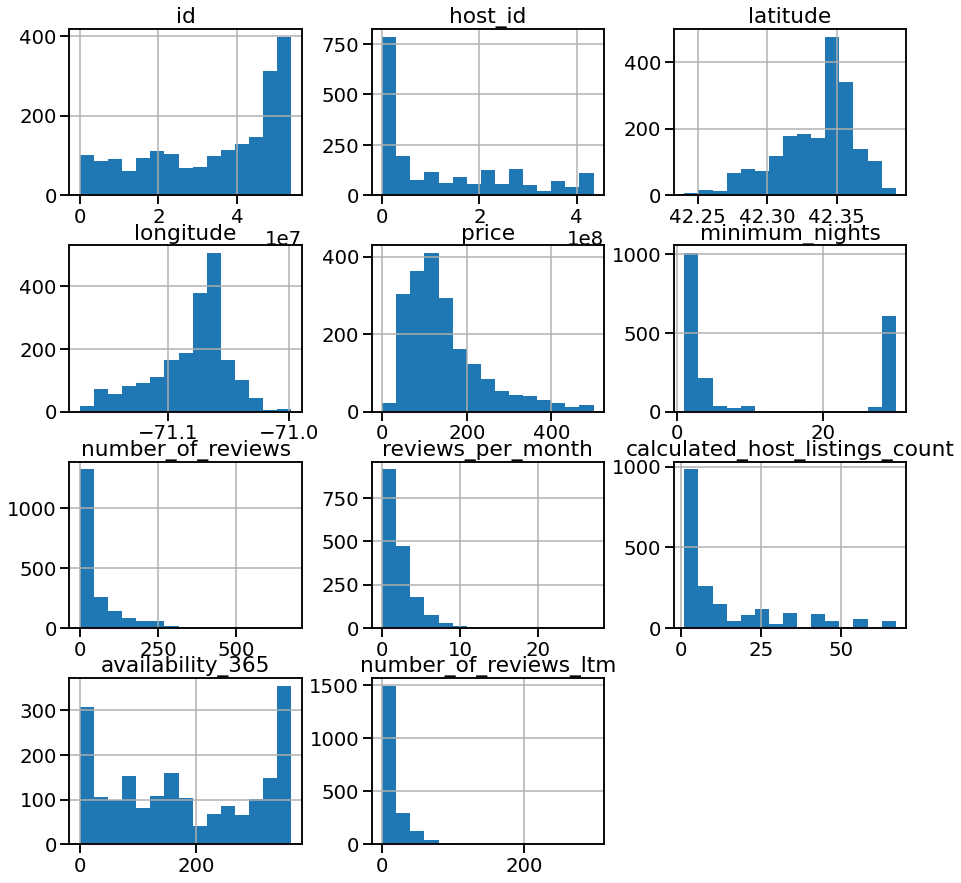

In [ ]:
df_clean = df.copy()
df_clean.drop(df_clean[df_clean.price > 500].index, axis=0, inplace=True)
df_clean.drop(df_clean[df_clean.minimum_nights > 30].index, axis=0, inplace=True)

# Buscou-se remover a variável `neighbourhood_group`, pois encontra-se vazia.
# Buscou-se remover a variável `license`, já que não será utilizada.


df_clean.drop('neighbourhood_group', axis=1, inplace=True)
df_clean.drop('license', axis=1, inplace=True)

# E na sequência buscou-se plotar novamente o histograma para as variáveis numéricas.

df_clean.hist(bins=15, figsize=(15,15));


In [ ]:
mediana = df_clean.median().values
mediana

In [ ]:
cols =['id', 'host_id','latitude', 'longitude', 'price', 'last_review',
       'minimum_nights', 'number_of_reviews','reviews_per_month',
       'calculated_host_listings_count','availability_365', 'number_of_reviews_ltm']

In [ ]:
for i in range(len(mediana)):
  df_clean[cols[i]] = df_clean[cols[i]].fillna(mediana[i])



In [ ]:
for col in df_clean.columns:
  perc=np.mean(df_clean[col].isna())
  print(f'{col}: {round(perc*100)} %')

In [ ]:
df_clean.isnull().sum()

id                                  0
name                                0
host_id                             0
host_name                          10
neighbourhood                       0
latitude                            0
longitude                           0
room_type                           0
price                               0
minimum_nights                      0
number_of_reviews                   0
last_review                       288
reviews_per_month                 288
calculated_host_listings_count      0
availability_365                    0
number_of_reviews_ltm               0
dtype: int64

In [ ]:
df_clean.plot.scatter(x='number_of_reviews', y='price', figsize=(20,8));

In [ ]:
plt.figure(figsize=(20,8))
#plt.scatter(np.log(1+df_clean['number_of_reviews']), df_clean['price'])
sns.pairplot(df_clean, x_vars=['number_of_reviews'], y_vars='price', size=40, aspect=0.7, kind='reg')

In [ ]:
df_clean['log_number_of_reviews'] =np.log (1 + df_clean['number_of_reviews'])

In [ ]:
data = df_clean.copy()
print('Quantidade de dados Originais: ' + str(len(data)))
data = data[data['number_of_reviews'] > 10]
print('Quantidade de dados após remover as propriedades de "poucas avaliações": ' + str(len(data)))

Quantidade de dados Originais: 1981
Quantidade de dados após remover as propriedades de "poucas avaliações": 1212


In [ ]:
data = pd.get_dummies(data)
data.head()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,...,last_review_2021-12-07,last_review_2021-12-08,last_review_2021-12-09,last_review_2021-12-10,last_review_2021-12-11,last_review_2021-12-12,last_review_2021-12-13,last_review_2021-12-14,last_review_2021-12-15,last_review_2021-12-16
1,5506,8229,42.32844,-71.09581,99,3,110,0.71,10,75,...,0,0,0,0,0,0,0,0,0,0
2,6695,8229,42.32802,-71.09387,250,3,116,0.77,10,127,...,0,0,0,0,0,0,0,0,0,0
9,18711,71783,42.32212,-71.06096,111,30,52,0.37,27,200,...,0,0,0,0,0,0,0,0,0,0
10,22354,85770,42.34487,-71.07441,148,29,315,2.49,4,89,...,0,0,0,0,0,0,0,0,0,0
11,29765,128280,42.37754,-71.06642,226,2,98,0.70,1,1,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
X = data.copy().drop(['price', 'host_id', 'id', 'minimum_nights', 
                      'reviews_per_month', 'calculated_host_listings_count', 
                      'availability_365'], axis = 1)
y = data['price'].copy()

In [ ]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet, RidgeCV, LassoCV, ElasticNetCV
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import random

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y)


In [ ]:
scaler = StandardScaler()
scaler.fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [ ]:
baseline = y_train.median() #median train
print('Se tomarmos apenas o valor mediano, nossa linha de base, diríamos que uma pernoite em Boston custa: ' + str(baseline))

Se tomarmos apenas o valor mediano, nossa linha de base, diríamos que uma pernoite em Boston custa: 125.0


In [ ]:
baseline_error = np.sqrt(mean_squared_error(y_pred=np.ones_like(y_test) * baseline, y_true=y_test))
print('E teremos uma variação de +- ' + str(baseline_error), 'dólares')

E teremos uma variação de +- 85.05631991660452 dólares


In [ ]:
lr = LinearRegression()
alphas = [1000, 100, 50, 20, 10, 1, 0.1, 0.01]
l1_ratios = [0.001, 0.01, 0.05, 0.1, 0.3, 0.5, 0.7, 0.9]
ridge = RidgeCV(alphas=alphas)
lasso = LassoCV(alphas=alphas, max_iter=10000)
elastic = ElasticNetCV(alphas=alphas, l1_ratio=l1_ratios)

In [ ]:
for model, name in zip([lr, ridge, lasso, elastic], ['LinearRegression', 'Ridge', 'Lasso', 'ElasticNet']):
    model.fit(X_train_scaled, y_train)
    y_pred_train = model.predict(X_train_scaled)
    mrse_train = np.sqrt(mean_squared_error(y_pred=y_pred_train, y_true=y_train))
    y_pred = model.predict(X_test_scaled)
    mrse_test = np.sqrt(mean_squared_error(y_pred=y_pred, y_true=y_test))
    best_alpha = ''
    if name != 'LinearRegression':
        best_alpha = ' best alpha: ' + str(model.alpha_)
    best_l1 = ''
    if name == 'ElasticNet':
        best_l1 = ' best l1: '+ str(model.l1_ratio_)
    print(name + ', mrse_test: ' + str(mrse_test) + best_alpha + best_l1)

LinearRegression, mrse_test: 68.46740687081427
Ridge, mrse_test: 68.37865425043229 best alpha: 10.0
Lasso, mrse_test: 70.21860819961132 best alpha: 0.01
ElasticNet, mrse_test: 69.00250985520286 best alpha: 0.01 best l1: 0.9


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.101e+03, tolerance: 6.768e+02
  coef_, l1_reg, l2_reg, X, y, max_iter, tol, rng, random, positive


In [ ]:
order = np.argsort(np.abs(lasso.coef_))[::-1]
for i in order:
    coef_ = lasso.coef_[i]
    if coef_ > 0:
        print(X.columns[i] + ', ' + str(lasso.coef_[i]))

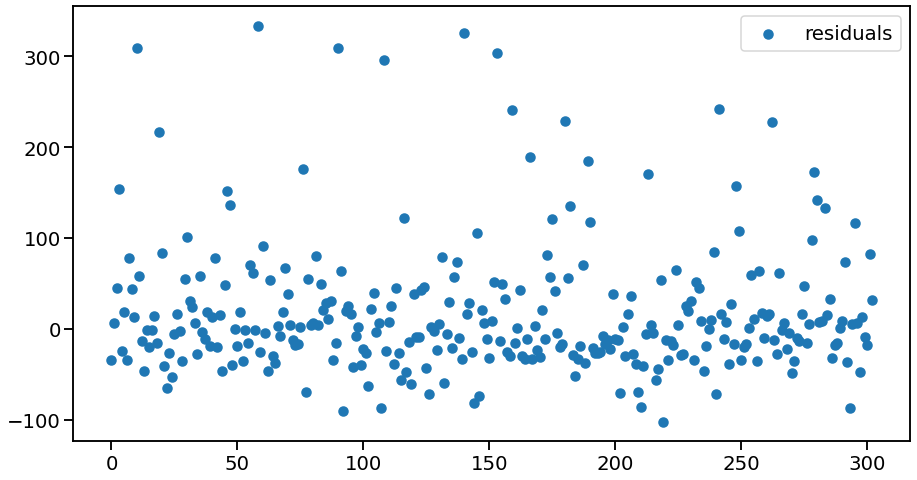

In [ ]:
y_pred_test = lasso.predict(X_test_scaled)
diff = y_test - y_pred_test
plt.figure(figsize=(15,8))
plt.scatter(np.arange(len(diff)), diff, label = 'residuals')
plt.legend()

In [ ]:
high_error = X_test[np.abs(diff) > 80]
print('size high error: ' + str(len(high_error)))
low_error = X_test[np.abs(diff) < 10]
print('size low error: ' + str(len(low_error)))

size high error: 43
size low error: 56


Tendo em vista que 75% das locações de Boston custam menos de 187,00 dólares, a acurácia da previsão do algoritmo implementado não ́e satisfatória, variando em tornode 36,5% da média de uma diária na cidade. Sendo assim, ́e devido dizer que há a necessidade de uma reavaliação dos dados usados além da implementação de outro tipo de algoritmo para melhor utilização da base de dados.


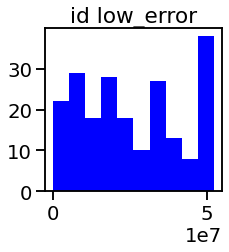

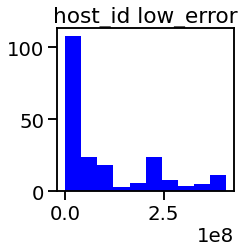

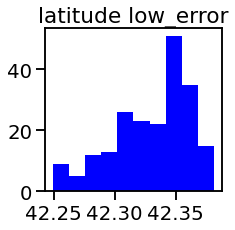

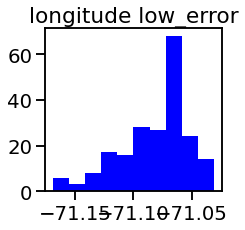

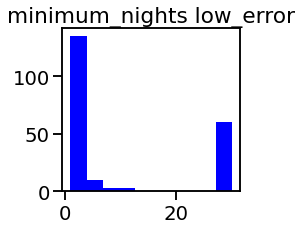

...

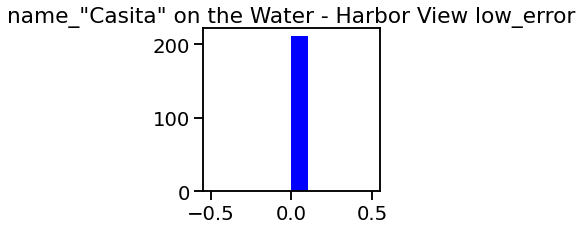

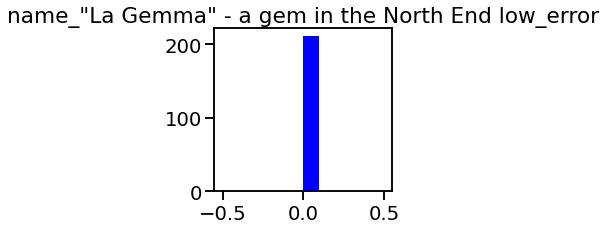

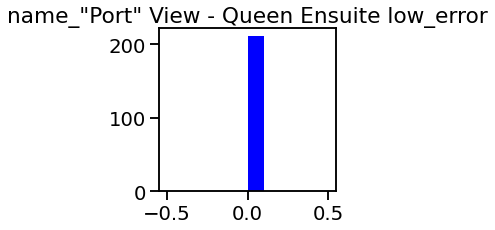

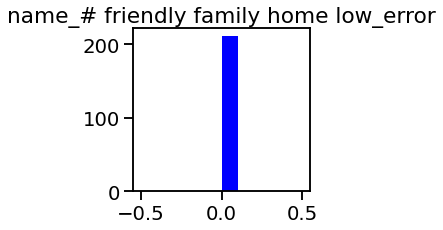

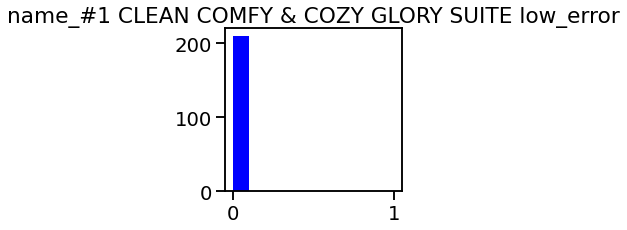

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 20840 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 27155 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 31105 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 28895 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 35762 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 22269 missing from current font.
  font.set_

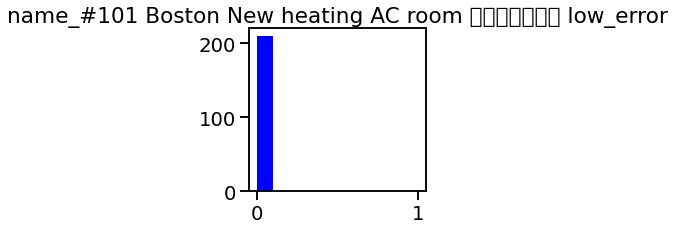

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 21487 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 27490 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 21560 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 21487 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 27490 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 21560 missing from current font.
  font.set_text

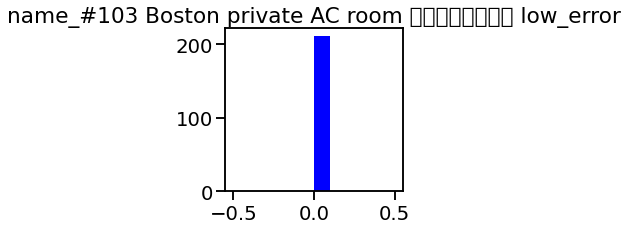

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 29420 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 31435 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 25151 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 27004 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 29420 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 31435 missing from current font.
  font.set_te

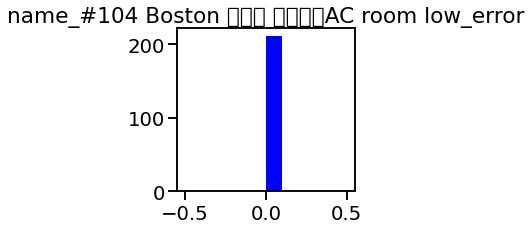

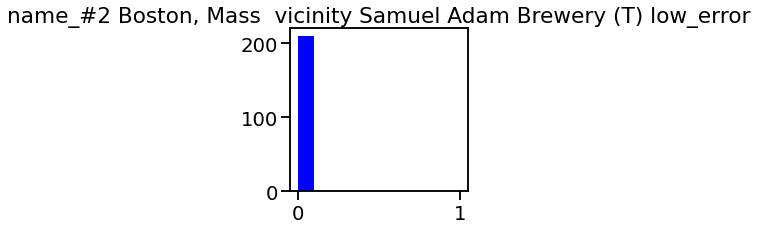

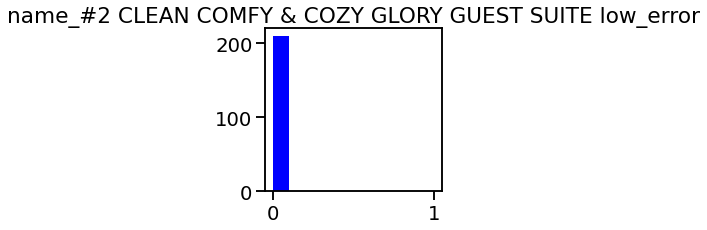

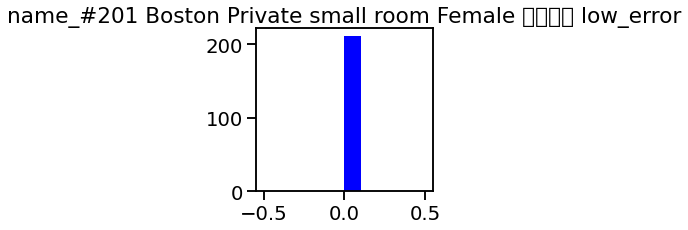

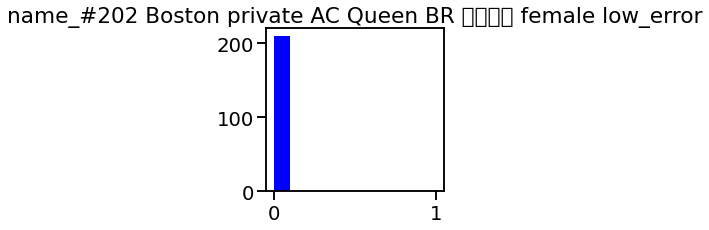

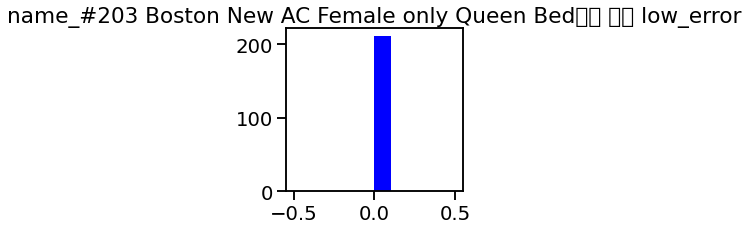

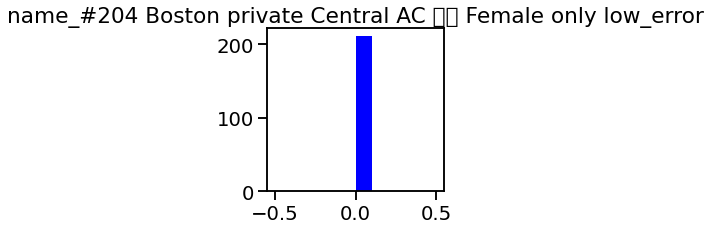

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 21452 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 24202 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 21452 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 24202 missing from current font.
  font.set_text(s, 0, flags=flags)


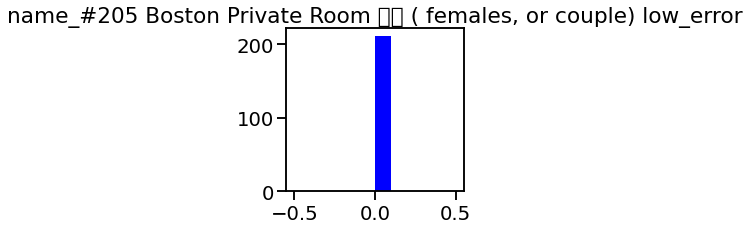

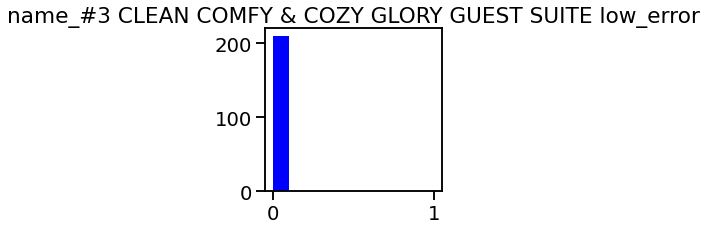

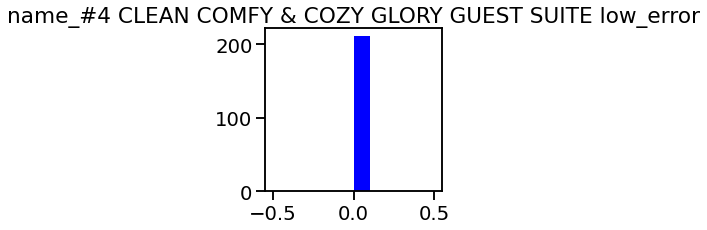

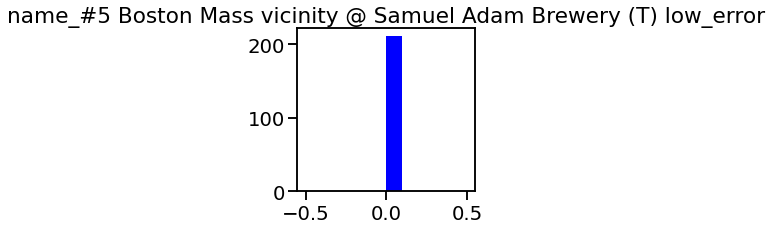

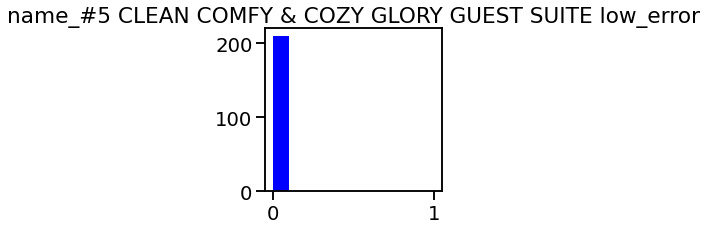

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 21416 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 20855 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 40784 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 22791 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 21416 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 20855 missing from current font.
  font.set_te

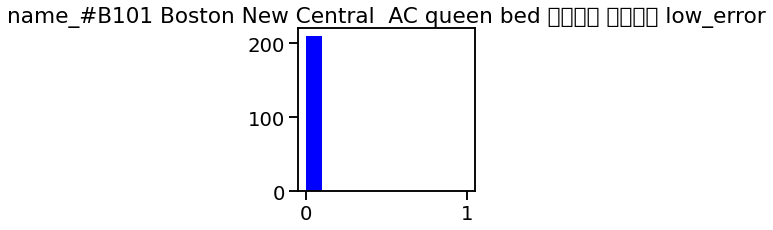

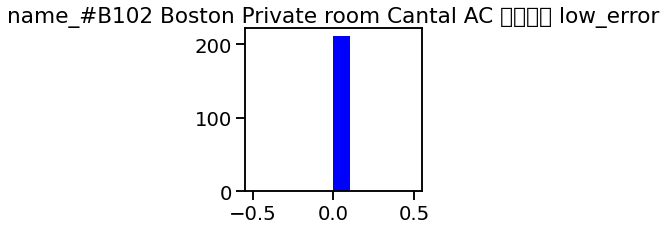

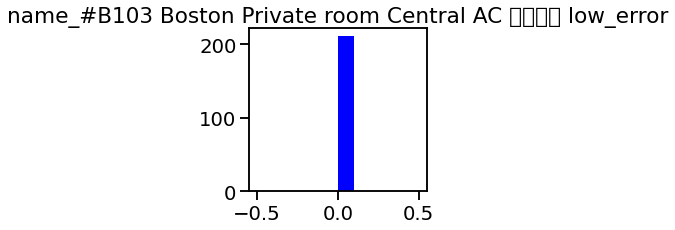

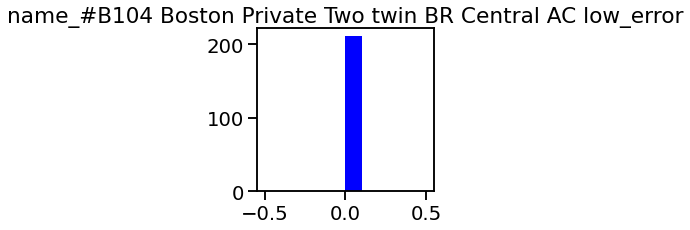

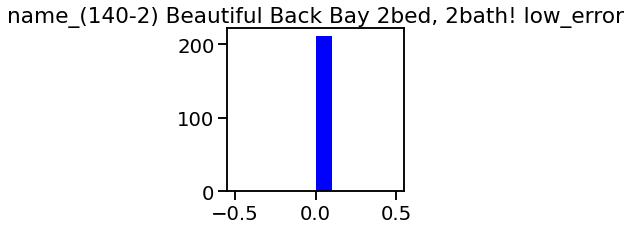

...

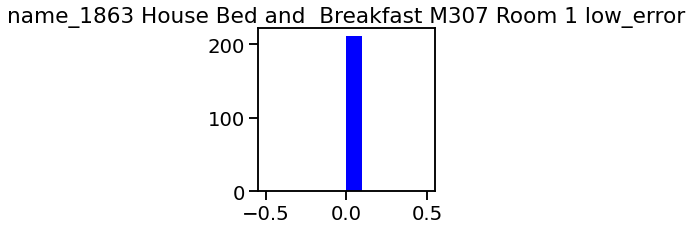

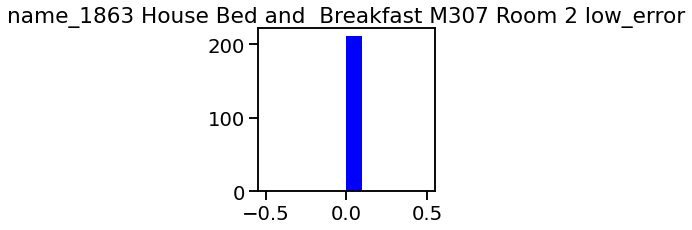

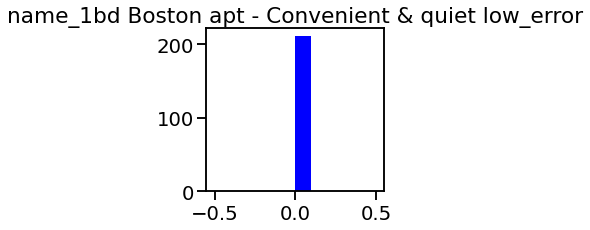

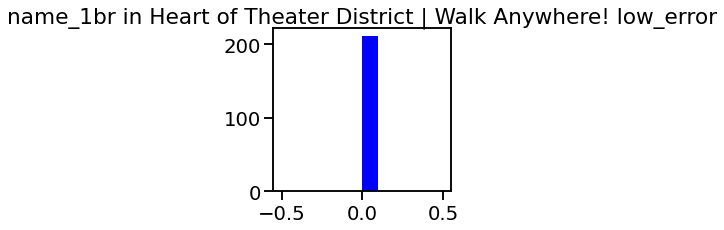

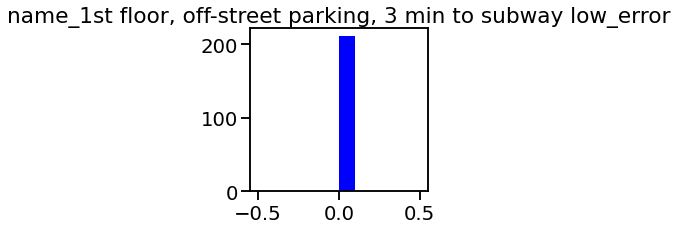

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 127894 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 127894 missing from current font.
  font.set_text(s, 0, flags=flags)


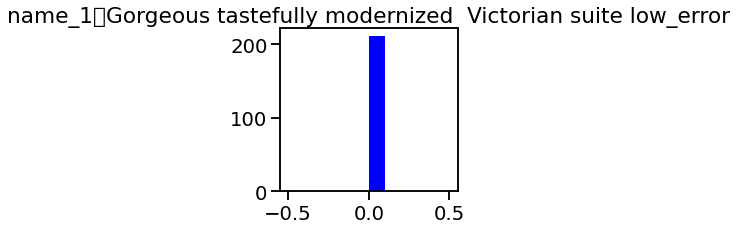

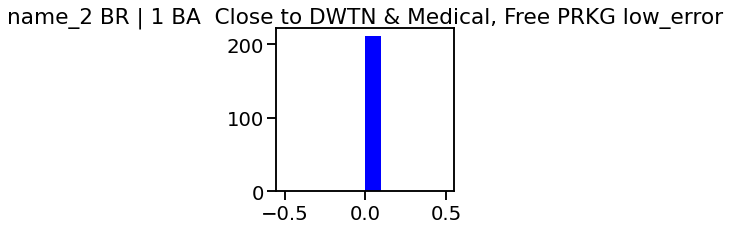

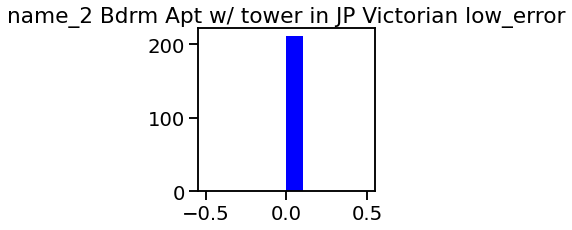

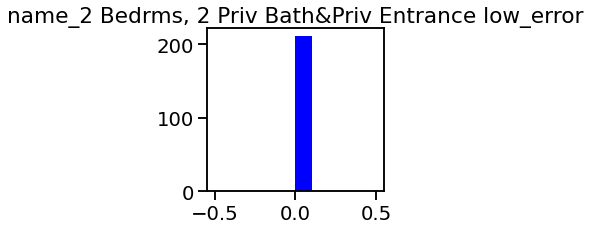

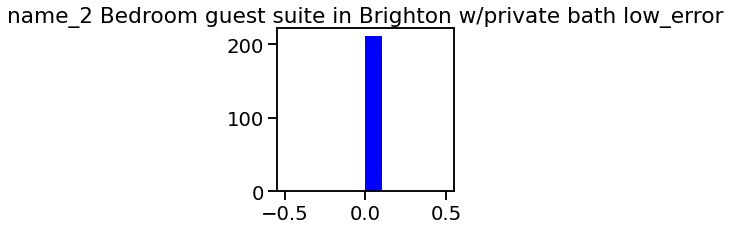

...

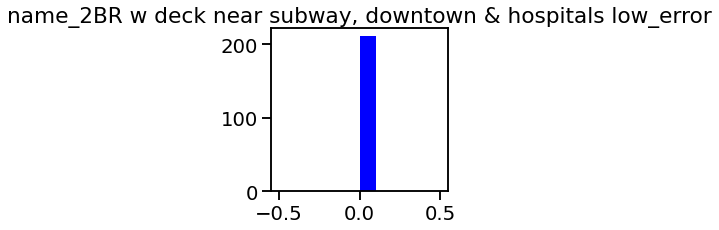

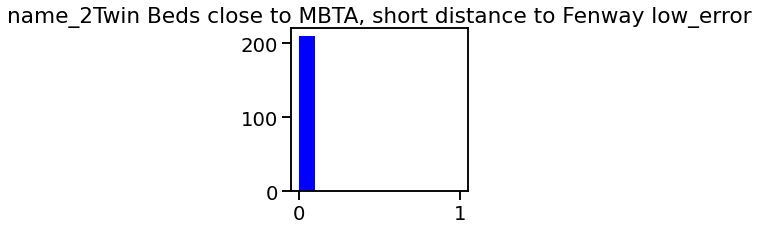

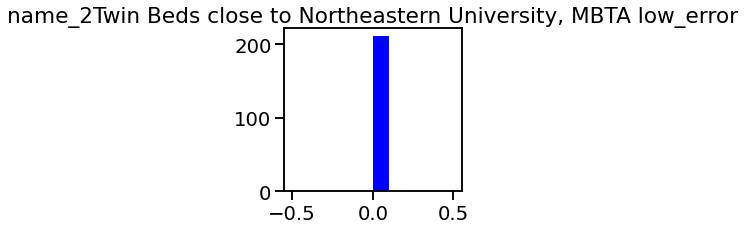

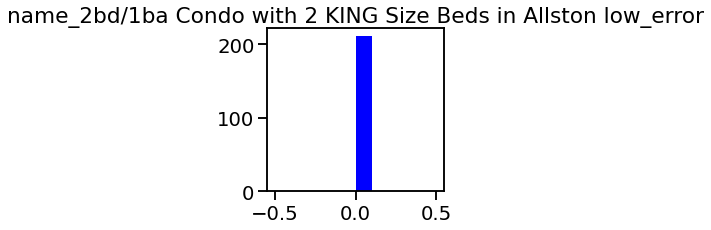

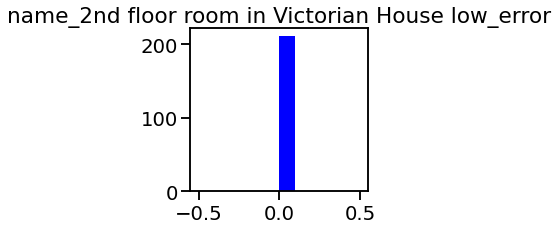

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 10024 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 10024 missing from current font.
  font.set_text(s, 0, flags=flags)


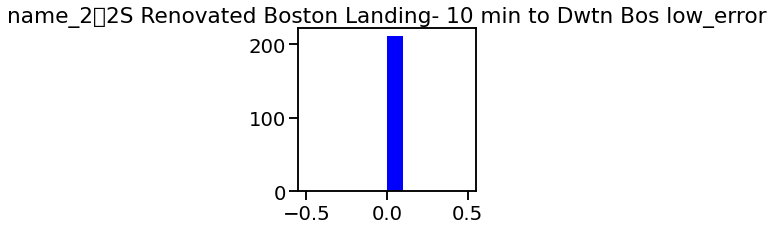

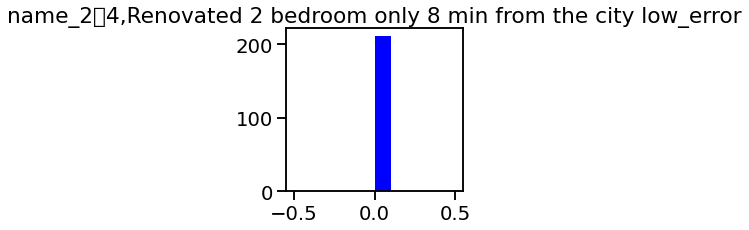

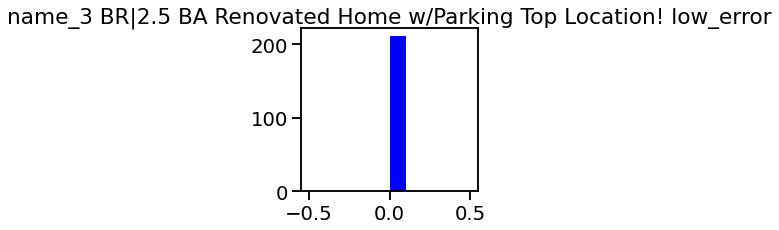

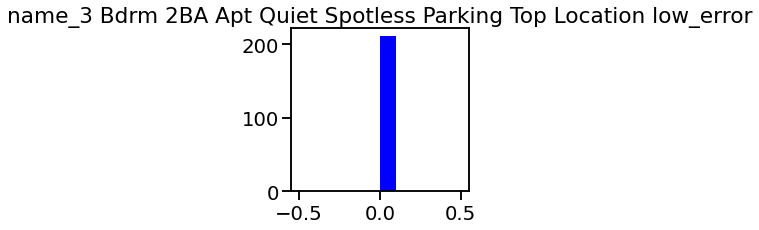

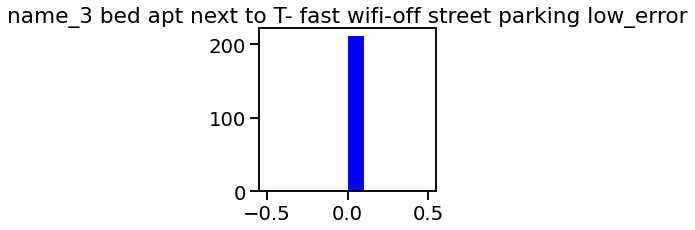

...

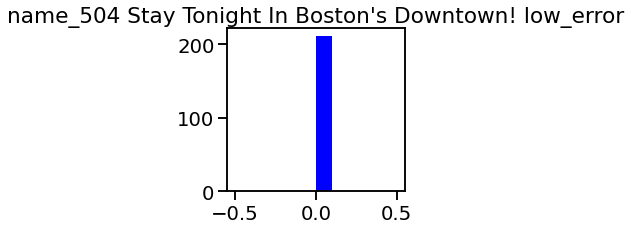

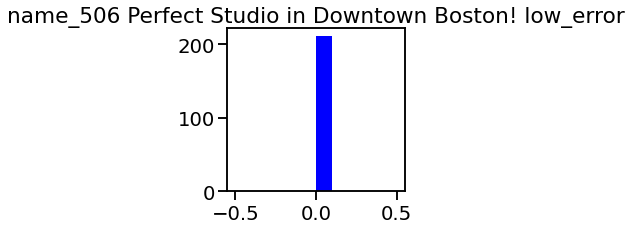

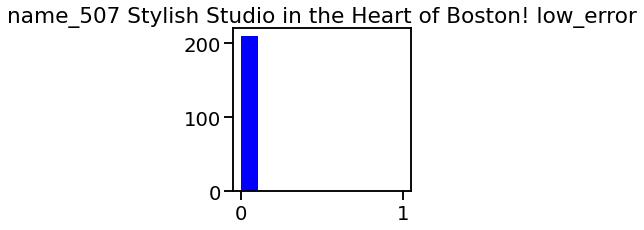

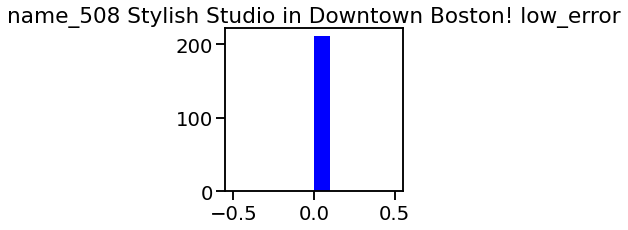

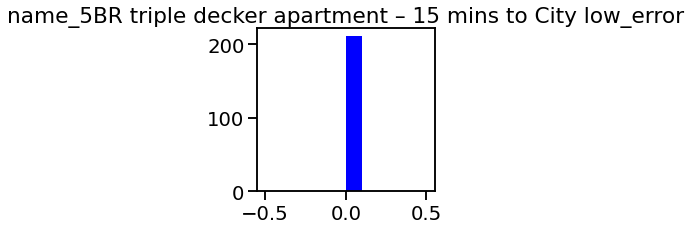

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 11088 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 11088 missing from current font.
  font.set_text(s, 0, flags=flags)


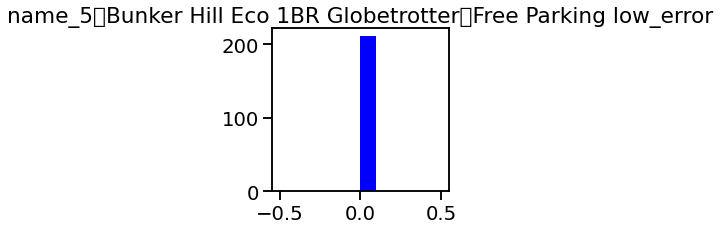

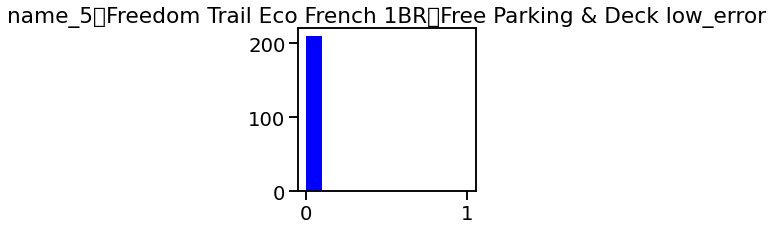

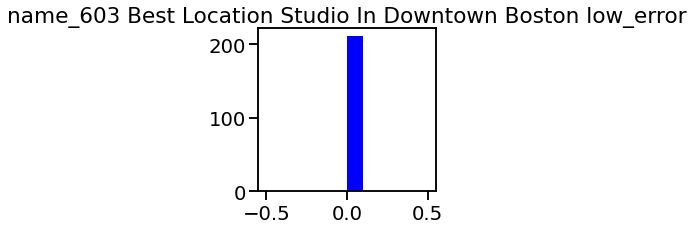

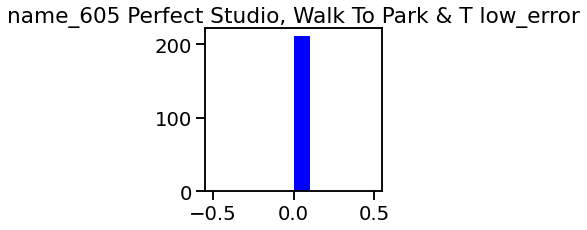

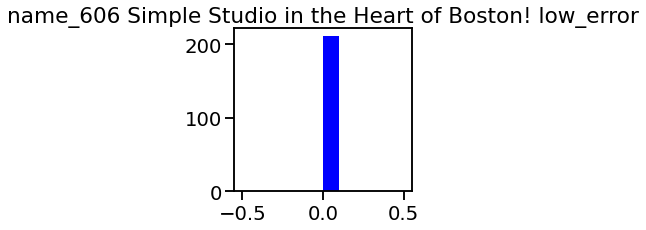

...

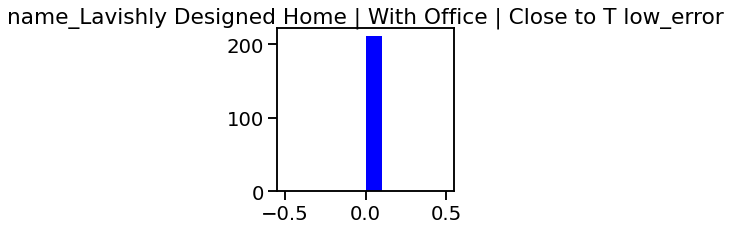

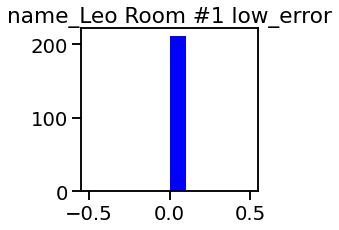

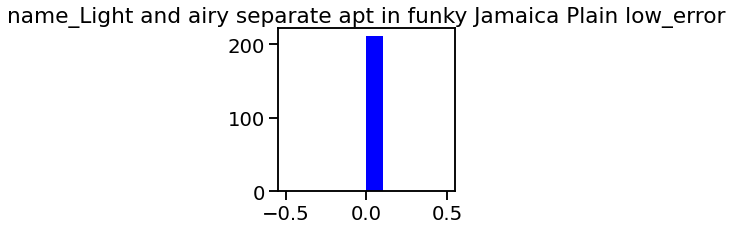

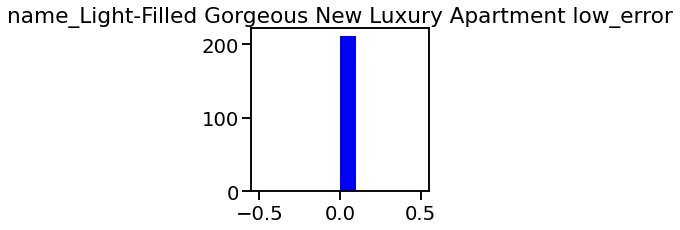

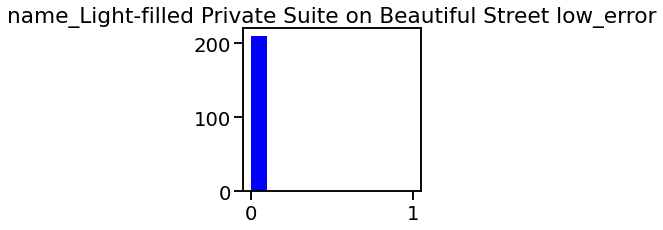

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 26089 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 39184 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 26089 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 39184 missing from current font.
  font.set_text(s, 0, flags=flags)


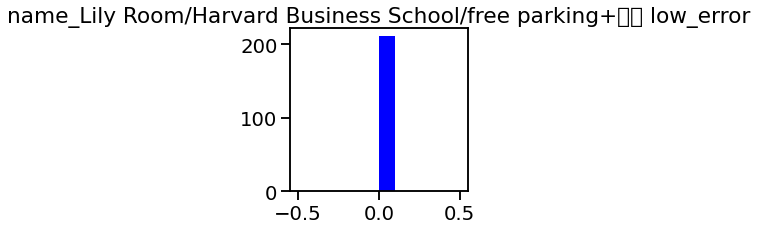

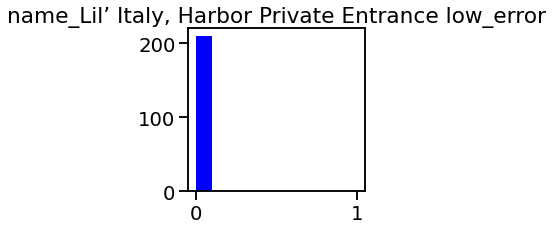

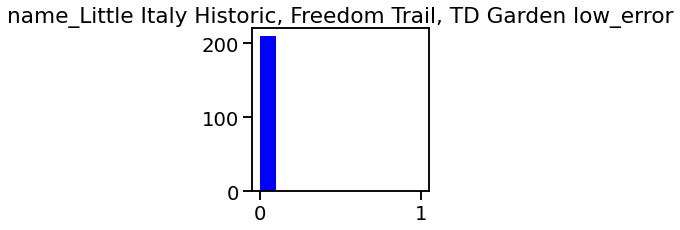

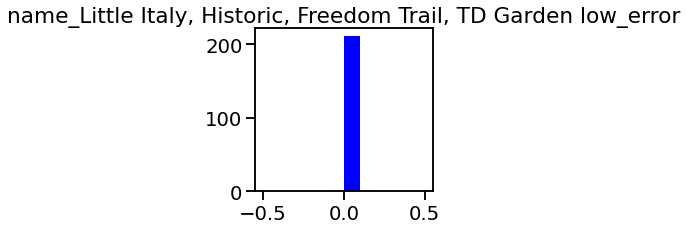

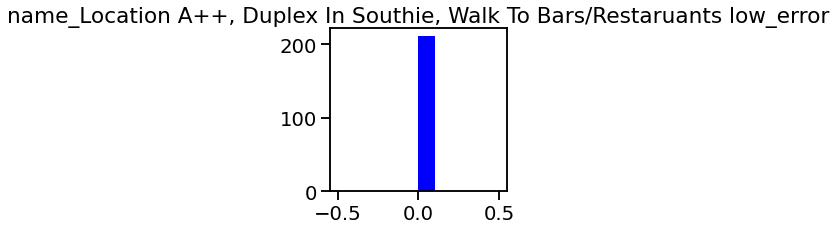

...

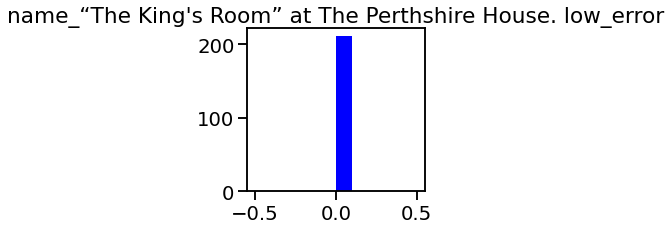

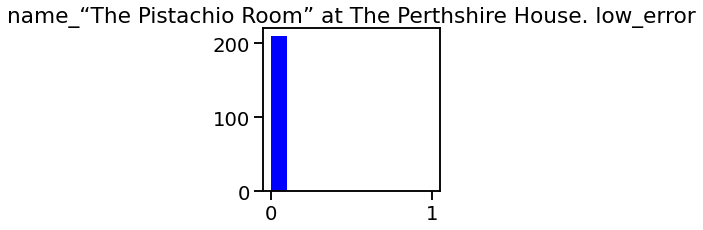

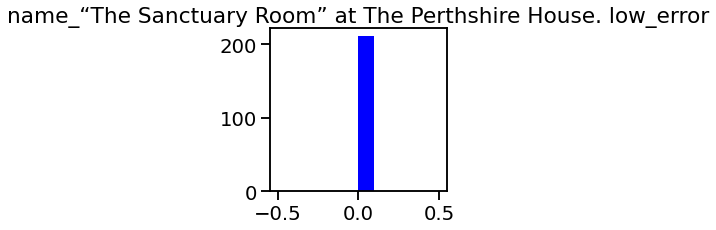

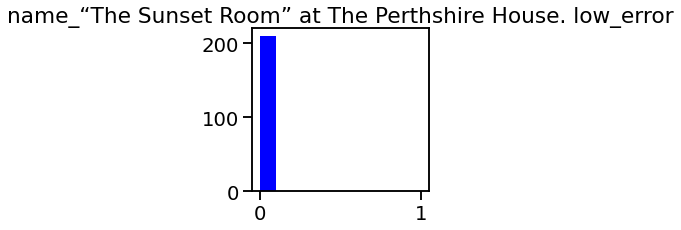

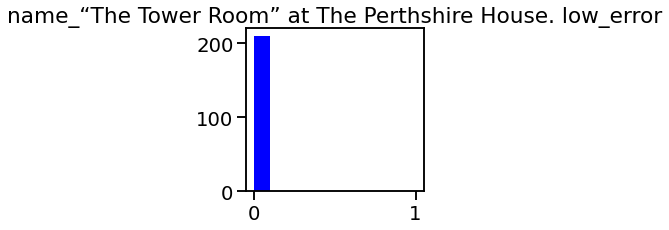

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 9055 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 9055 missing from current font.
  font.set_text(s, 0, flags=flags)


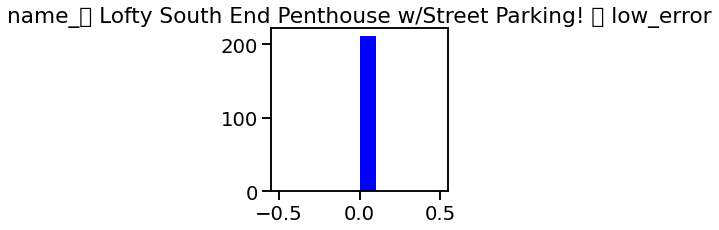

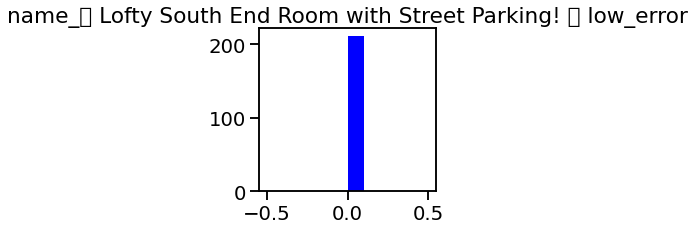

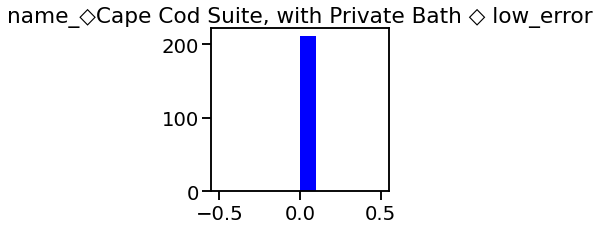

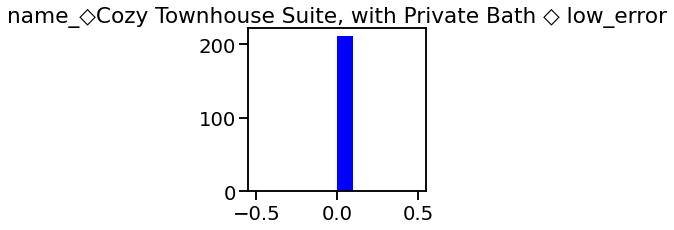

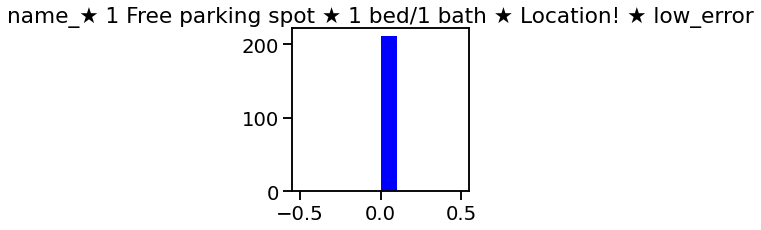

...

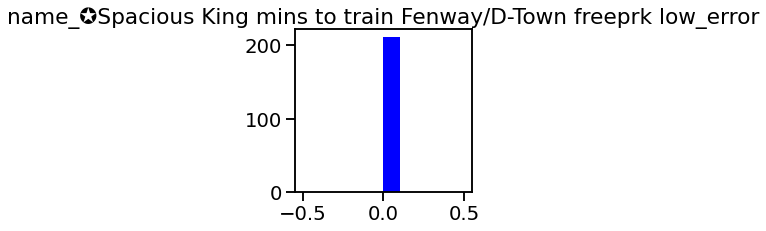

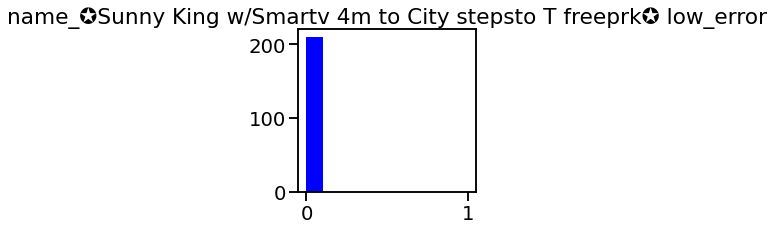

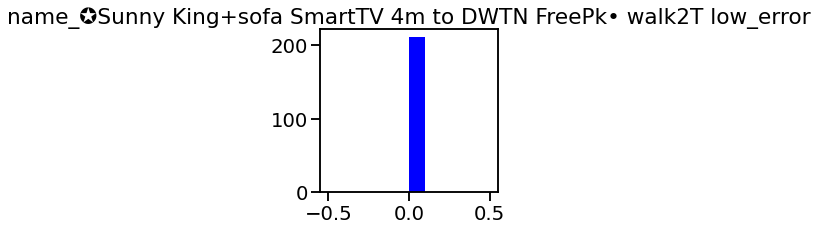

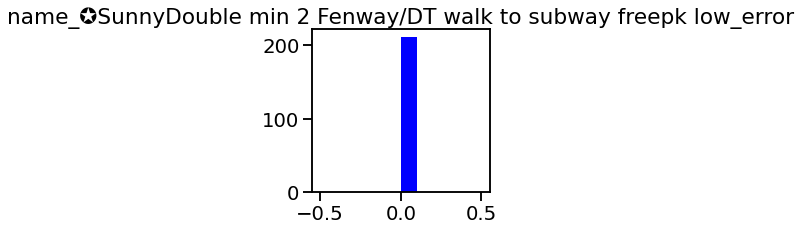

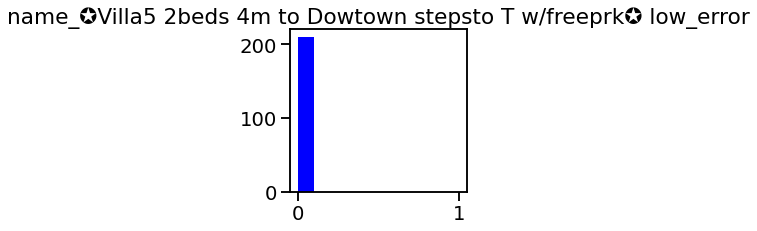

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 127795 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 128054 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 127795 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 128054 missing from current font.
  font.set_text(s, 0, flags=flags)


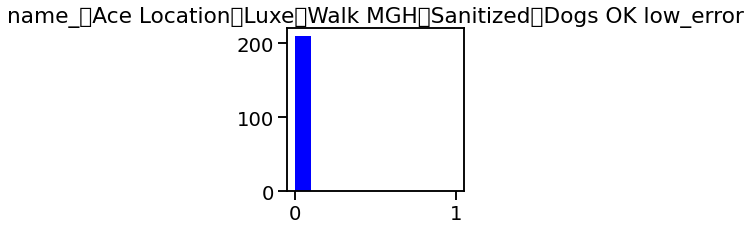

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 129293 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 128153 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 129293 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 128153 missing from current font.
  font.set_text(s, 0, flags=flags)


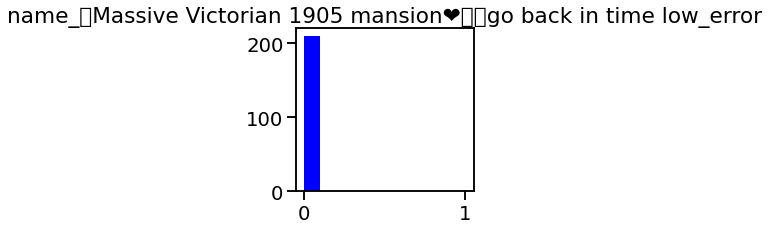

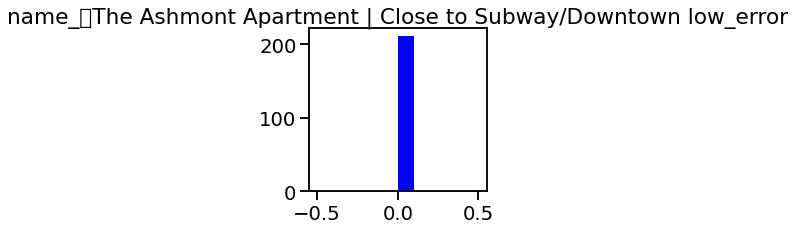

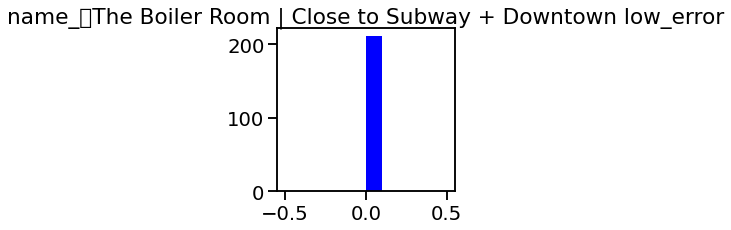

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 127942 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 127942 missing from current font.
  font.set_text(s, 0, flags=flags)


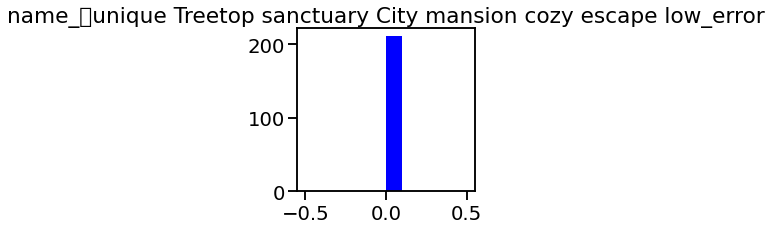

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 127976 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 127939 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 127803 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 127976 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 127939 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 127803 missing from current font.
  font.se

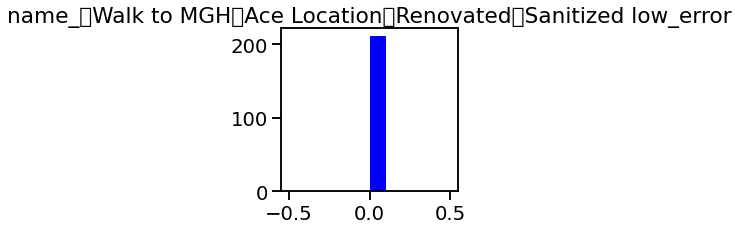

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 128142 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 127807 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 128142 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 127807 missing from current font.
  font.set_text(s, 0, flags=flags)


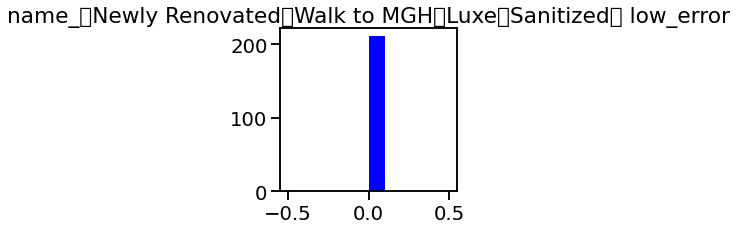

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 129530 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 129530 missing from current font.
  font.set_text(s, 0, flags=flags)


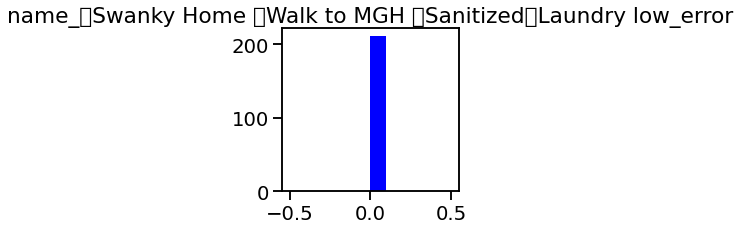

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 128293 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 128293 missing from current font.
  font.set_text(s, 0, flags=flags)


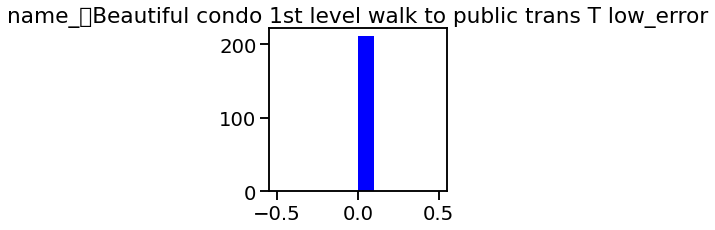

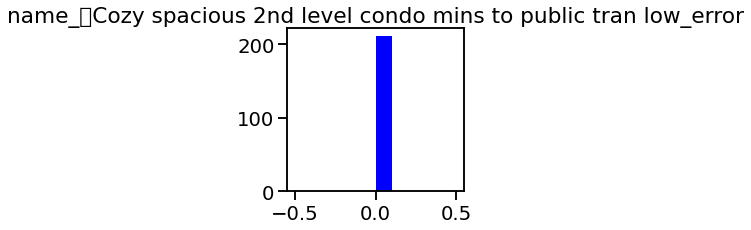

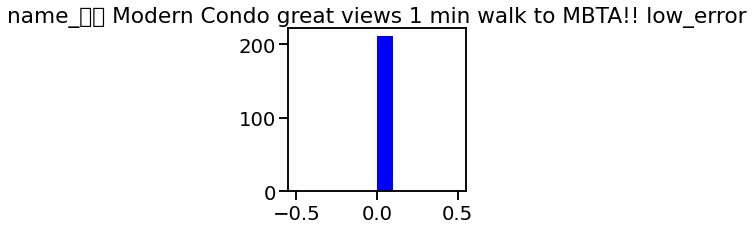

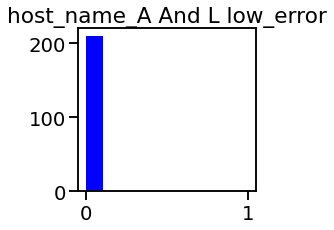

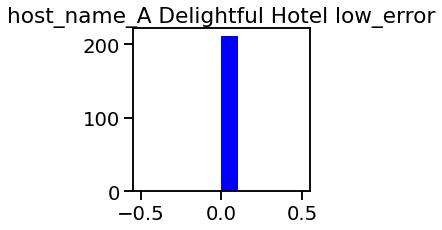

...

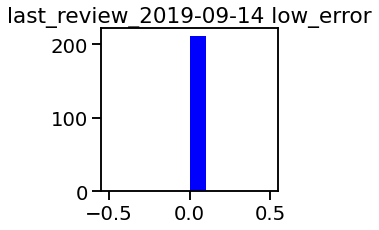

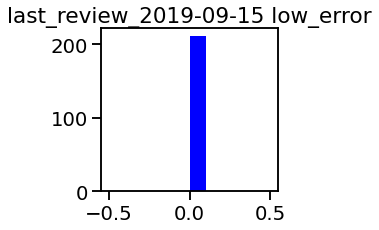

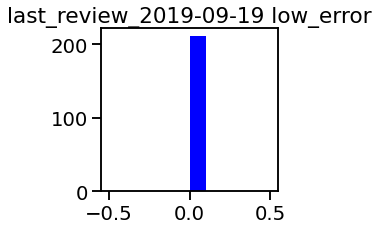

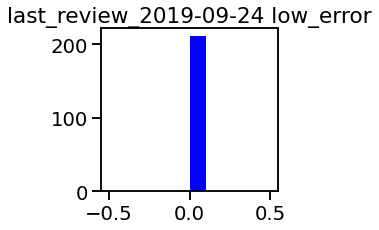

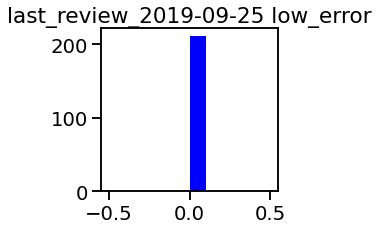

KeyboardInterrupt: ignored

In [ ]:
for c in high_error.columns:
    plt.figure(figsize=(7,3))
    plt.subplot(121)
    plt.hist(low_error[c], color='b')
    plt.title(c + ' low_error')
    plt.subplot(122)
    plt.hist(high_error[c], color='r')
    plt.title(c + ' high_error')
    plt.show()

**Quanto ao novo conjunto de dados (df_clean), podemos verificar que:**

* Conseguimos identificar uma clara distribuição de valores nos histogramas das variáveis  **minimum_nights** e **price** sem a presença de outliers.

* Buscou-se eliminar a variável numérica **neighbourhood_group** pois a mesma não agregava valor ao conjunto de dados.

* Buscou-se eliminar a variável objeto **license** pois a mesma não seria utilizado.

##### **C2.Correlação dos Dados**

Nesta etapa vamos selecionar quais colunas, variáveis ou features serão selecionadas para comporem o nosso modelo de DS considerando suas importâncias no conjunto de dados. Vamos utilizar uma técnica de correlação estatística sobre as variáveis numéricas.

In [ ]:
# Construiu-se uma matriz de correlação entre as variáveis numéricas dataset df_clean.

corr = df_clean[['price', 'minimum_nights', 'number_of_reviews', 'reviews_per_month',
    'calculated_host_listings_count', 'availability_365']].corr()

display(corr)

,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
price,1.000000,-0.068543,-0.069923,0.001461,-0.012056,0.116850
minimum_nights,-0.068543,1.000000,-0.146575,-0.311680,0.003150,0.017994
number_of_reviews,-0.069923,-0.146575,1.000000,0.507840,-0.131054,-0.022089
reviews_per_month,0.001461,-0.311680,0.507840,1.000000,-0.014301,0.013625
calculated_host_listings_count,-0.012056,0.003150,-0.131054,-0.014301,1.000000,0.116690
availability_365,0.116850,0.017994,-0.022089,0.013625,0.116690,1.000000


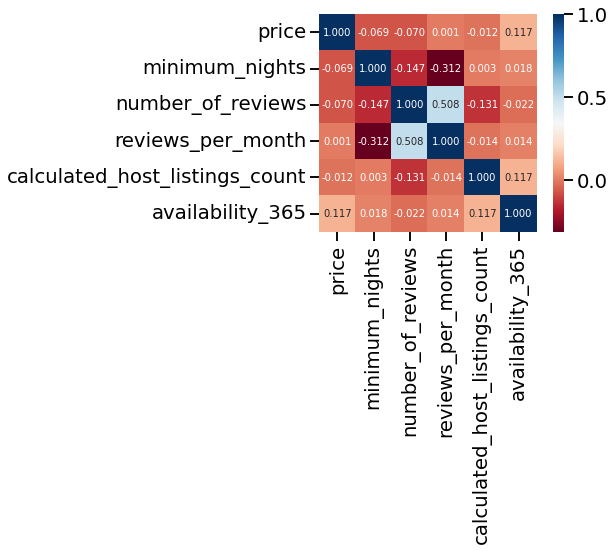

In [ ]:
# Na sequência buscou-se construir um mapa de calor (heatmap) a partir dessa matriz.

sns.heatmap(corr, cmap='RdBu', fmt='.3f', square=True, linecolor='white', annot=True);


**Quanto matriz de correlação e o mapa de calor, podemos verificar que:**

* Conseguimos identificar na matriz e mapa de calor as correlação entre as variáveis plotadas duas a duas nos gráficos, ficando claro que o intervalo de análise varia de (-1 a +1) com forte correlação positiva ou negativa entre variáveis para valores próximos de (+1 ou -1), bem como fraca correlação para valores próximos de (0).

* No presente caso identificamos baixa correlação (0) entre as variáveis em análise, com exceção das variáveis numéricas **number_of_reviews** e **reviews_por_month)** que apresentam uma correlação positiva bastante interessante **(0.504)**.

### **D. Construindo o Modelo de DS**: 

Nesta etapa serão selecionadas técnicas de modelagem em Data Science, gerando um design de teste, construindo possíveis modelos para DS como modelos de  machine learning, deep learning, inteligência artificial, análise exploratório de dados (tabelas, gráficos, BI), dentre outras técnicas disponíveis, e por fim, o modelo será avaliado quanto à qualidade das suas previsões (métricas de avaliação do modelo).

##### **D1. Análise Exploratória de Dados - Problemas Investigados no Projeto de DS**

* Quais os principais tipos de imóveis locados na cidade de Boston?
* Quais os bairros com maior custo de locação na cidade de Boston?
* Qual o custo médio de locação das unidades na cidade de Boston?
* Qual a quantidade média de diárias por locação na cidade de Boston?
* Qual a disponibidade médias dos imóveis na cidade de Boston?



**Ranking dos principais tipos de imóveis locados em Boston?**

In [ ]:
# Identificando a quantidade de imóveis por tipo de imóvel disponível. Foi utilizado o método value_counts().

df_clean.room_type.value_counts()

Entire home/apt    1252
Private room        702
Hotel room           22
Shared room           5
Name: room_type, dtype: int64

In [ ]:
# Verificando o percentual de cada tipo de imóvel no total do conjunto de dados.

df_clean.room_type.value_counts() / df_clean.shape[0]

Entire home/apt    0.632004
Private room       0.354366
Hotel room         0.011106
Shared room        0.002524
Name: room_type, dtype: float64

**Quanto aos tipos de imóveis mais locados, podemos verificar que:**

* A coluna da variável categórica **room_type** indica o tipo de locação que está anunciada no Airbnb. Sendo que existem opções de **espaço inteiro**(apartamentos/casas), **quarto inteiro**, **quarto compartilhado** e  **quarto de hotel**.

* Numa simples análise podemos verificar que quase **64%** dos imóveis locados pela AirBnb em Boston estão na categoria de **espaços inteiros** de casa e ou apartamentos.

* Na sequência com quase **35%** temos os **quartos inteiros** (tenha seu próprio quarto e compartilhe alguns espaços comuns).

* Na categoria de **quartos compartilhados** (fique em um espaço compartilhado, como um quarto comum) temos **1%**.

* E por fim, temos **quarto de hotal** (fique em um quarto inteiro ou compartilhado em um hotel boutique, albergue e outros lugares) com ínfimos **0,2%**.

In [ ]:
# Construindo uma análise de uma varíavel (neighbourhood) em função de outra varíavel (price) usando a função groupby.

df_clean.groupby(['neighbourhood']).price.mean().sort_values(ascending=False)[:15]

neighbourhood
Chinatown                  241.222222
Longwood Medical Area      219.000000
Charlestown                202.703704
Fenway                     200.375000
North End                  196.944444
Downtown                   184.539906
South Boston Waterfront    182.222222
Back Bay                   180.517241
South Boston               166.058140
Jamaica Plain              162.600000
West End                   160.000000
Beacon Hill                156.185185
South End                  150.919540
Allston                    150.229730
East Boston                137.592000
Name: price, dtype: float64

**Quanto aos bairros com maior custo de locação do imóvel, podemos verificar que:**

* A coluna da variável numérica **price** indica o preço para alugar o imóvel na Airbnb. Dessa forma, combinando os valores da variável **price** com os valores da variável **neighbourhood** podemos encontrar os valores médios por bairro na cidade de Boston com uso da função groupby.

* No output acima, podemos identificar que existe uma media de valores parecidas em todas os bairros. 

* O que nos leva a necessidade **insvestigarmos novamente** nossa base de dados para verificar a representatividade das amostras de bairros como Vaz Lobo, Engenheiro Leal, Ricardo de Albuquerque e Paciência no conjunto de toda base de dados. **O que sinaliza que a metodologia CRISP-DM apesar de dividida em etapas e construída de forma sequêncial, deve ser aplicada de forma iterativa e interativa.** No caso em tela fica claro que teríamos que voltar à fase de **preparação dos dados** para aplicação de técnicas de limpeza e transformação de dados para minimizar as ocorrências identificadas.


**Reanálise dos valores médios de locação de imóvel por bairro considerando o contexto socioeconômicoem Boston.**

In [ ]:
# Verificando a quantidade de imóveis no bairro Chinatown no contexto de todo dataset.

print(df_clean[df_clean.neighbourhood == "Chinatown"].shape)

df_clean[df_clean.neighbourhood == "Chinatown"]

(18, 16)


,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
745,17559493,"NEW 2nd Floor, 2BR Downtown Boston",118122992,Billy,Chinatown,42.34903,-71.06200,Entire home/apt,300,3,174,2021-11-14,3.01,4,146,12
746,17559756,"NEW 3rd Floor, 2BR Downtown Boston",118122992,Billy,Chinatown,42.35030,-71.06037,Entire home/apt,300,3,141,2021-11-14,2.44,4,145,8
747,17559846,NEW B 1BR Downtown Boston,118122992,Billy,Chinatown,42.34835,-71.06039,Entire home/apt,125,29,209,2021-10-15,3.61,4,349,1
749,17573922,"NEW 1st Floor, 1BR Downtown Boston",118122992,Billy,Chinatown,42.34986,-71.06197,Entire home/apt,160,29,144,2021-10-03,2.49,4,243,2
1481,34279736,Lavish Boston Studio Apt Near Prudential Center!,163251048,Jen,Chinatown,42.35175,-71.05926,Entire home/apt,169,29,0,NaN,1.66,11,359,0
1986,44060731,Spacious 1 BR | Laundry | WiFi | Full Kitchen ...,9419684,Churchill,Chinatown,42.35147,-71.06019,Entire home/apt,265,29,0,NaN,1.66,32,365,0
1987,44131827,Modern 1 BR | Full kitchen | GYM | Washer/D | GLS,9419684,Churchill,Chinatown,42.35135,-71.06130,Entire home/apt,265,29,0,NaN,1.66,32,365,0
1991,44133273,Luxury 1 BR | Full kitchen | GYM | Washer/D | GLS,9419684,Churchill,Chinatown,42.35180,-71.06170,Entire home/apt,265,29,0,NaN,1.66,32,365,0
1992,44133942,Brand New 1 BR | Full Kitchen | GYM |Washer/D ...,9419684,Churchill,Chinatown,42.35120,-71.06109,Entire home/apt,265,29,0,NaN,1.66,32,365,0
1995,44135035,Exclusive 2BR | Furnished | Gym | Boston | GLS,9419684,Churchill,Chinatown,42.35131,-71.06037,Entire home/apt,369,29,0,NaN,1.66,32,365,0


In [ ]:
# Verificando a quantidade de imóveis no bairro Longwood Medical Area no contexto de todo dataset.

print(df_clean[df_clean.neighbourhood == "Longwood Medical Area"].shape)

df_clean[df_clean.neighbourhood == "Longwood Medical Area"]

(2, 16)


,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
1548,36002387,"The Inn at Longwood Medical, Two Queen Size Beds",266754484,Inn At Longwood Medical,Longwood Medical Area,42.33746,-71.10730,Private room,229,1,0,NaN,1.66,2,130,0
1549,36002511,"The Inn at Longwood Medical, One King Size Bed",266754484,Inn At Longwood Medical,Longwood Medical Area,42.33932,-71.10587,Private room,209,1,1,2020-02-18,0.04,2,130,0


In [ ]:
# Verificando a quantidade de imóveis no bairro Charlestown no contexto de todo dataset.

print(df_clean[df_clean.neighbourhood == "Charlestown"].shape)

df_clean[df_clean.neighbourhood == "Charlestown"]

(54, 16)


,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
11,29765,"Luxury suite, Moroccan furnishings",128280,Elizabeth,Charlestown,42.377540,-71.066420,Entire home/apt,226,2,98,2021-10-24,0.70,1,1,5
13,45987,Gorgeous Garden Studio Charlestown,205107,Atef,Charlestown,42.374240,-71.060810,Entire home/apt,125,29,131,2021-09-06,0.95,1,86,1
17,77681,Waterfall Room: Bunker Hill B&B,416912,Christiane,Charlestown,42.378650,-71.063730,Private room,140,2,57,2021-10-03,0.46,1,360,3
23,184893,Beautiful 1 bedroom apt cld sleep 4,887148,Dawn,Charlestown,42.378230,-71.067780,Private room,245,29,0,NaN,1.66,3,134,0
46,611081,Houseboat in Boston Harbor,3029783,Deborah,Charlestown,42.375790,-71.049810,Entire home/apt,200,2,53,2021-11-28,0.83,3,350,15
49,708802,Boston / Charlestown Apartment,3648427,Gerard And Marie,Charlestown,42.379260,-71.063640,Entire home/apt,200,2,374,2020-01-31,3.35,1,103,0
83,1445064,Bright Sunlit bedroom near Spaulding/Downtown,4724006,Rosalia,Charlestown,42.380170,-71.062360,Private room,45,29,109,2021-12-04,1.08,1,146,4
86,1541166,Beautiful Studio 15 min to Downtown,552418,Vanya,Charlestown,42.383240,-71.078520,Entire home/apt,109,2,42,2021-10-26,0.42,1,5,3
87,1544144,Charming Historic Home in Charlestown,7353037,Nancy And Tom,Charlestown,42.372430,-71.063490,Entire home/apt,350,3,29,2021-11-02,0.74,1,150,16
193,4525875,Charming & Historic 2 bed/2 bath w/ private patio,23462166,Corey,Charlestown,42.378660,-71.064520,Entire home/apt,363,4,55,2021-11-28,1.27,1,145,12


In [ ]:
# Verificando a quantidade de imóveis no bairro Fenway no contexto de todo dataset.

print(df_clean[df_clean.neighbourhood == "Fenway"].shape)

df_clean[df_clean.neighbourhood == "Fenway"]

(64, 16)


,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
200,4577188,Unique Fenway/Back Bay/Copley 1 Bed,5618949,Alan,Fenway,42.345000,-71.09514,Entire home/apt,148,3,174,2021-08-28,2.03,7,148,4
524,12672097,Boston Brownstone,46846483,Giannoula,Fenway,42.346260,-71.09049,Entire home/apt,202,2,163,2021-11-28,2.81,1,51,35
865,19540224,Free Parking at Newly Renovated 1 Bed Basement...,130680380,Jodie,Fenway,42.349400,-71.09566,Entire home/apt,150,9,197,2021-11-16,3.63,4,104,9
866,19574477,Gorgeous Audubon Circle Studios (1),70331522,Laurie,Fenway,42.346330,-71.10317,Entire home/apt,185,30,89,2020-03-07,1.70,2,270,0
881,19997604,Back Bay Apartment near MIT and Newbury Street,51079261,Riverside,Fenway,42.350950,-71.09009,Entire home/apt,225,2,35,2021-09-21,0.66,2,6,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3235,53448681,Beautiful sunny apartment in the heart of fenway,158837906,Hesham,Fenway,42.348420,-71.10165,Entire home/apt,299,28,0,NaN,1.66,34,347,0
3236,53449004,Wonderful Sunny luxury Apartment Heart of fenway,158837906,Hesham,Fenway,42.346190,-71.10051,Entire home/apt,299,7,0,NaN,1.66,34,365,0
3238,53461395,Sunny Gorgeous 2bed 2bath Apt middle of Fenway,158837906,Hesham,Fenway,42.342780,-71.10276,Entire home/apt,499,28,0,NaN,1.66,34,365,0
3255,53513507,Beautiful 2bed 2bath in fenway high end building,158837906,Hesham,Fenway,42.347997,-71.10157,Entire home/apt,449,30,0,NaN,1.66,34,350,0


**Quanto aos bairros com maior custo de locação do imóvel, após a reanálise, podemos verificar que:**

* Após a analise de cada um dos 4 bairros que aparecem no topo do ranking, eles não apresentam valores muito alto em relação aos demais o que torna pouco significativos quando considerando-se as quantidades de imóveis locados quando comparando-se ao todo.

**Qual o custo médio de locação das unidades em Boston?**

**Qual a quantidade média de diárias por locação em Boston?**

**Qual a disponibidade médias dos imóveis em Boston?**

In [ ]:
# Calculando as estatisticas descritivas do dataset df_clean com a retirada dos outliers.

df_clean[['price', 'minimum_nights', 'number_of_reviews', 'reviews_per_month',
    'calculated_host_listings_count', 'availability_365']].describe()

,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,1981.000000,1981.000000,1981.000000,1981.000000,1981.000000,1981.000000
mean,148.066633,11.054013,56.786471,2.106098,13.510348,182.095406
std,92.510893,12.726716,89.184574,2.063151,16.646519,128.318490
min,0.000000,1.000000,0.000000,0.020000,1.000000,0.000000
25%,88.000000,1.000000,3.000000,0.730000,2.000000,69.000000
50%,125.000000,2.000000,21.000000,1.660000,6.000000,168.000000
75%,187.000000,29.000000,68.000000,2.750000,21.000000,318.000000
max,500.000000,30.000000,678.000000,27.170000,67.000000,365.000000


In [ ]:
variancia = df_clean.loc[:,'price'].var(ddof=0)
desviopd = df_clean.loc[:,'price'].std(ddof=0)
media = df_clean.loc[:,'price'].mean()
median = df_clean.loc[:,'price'].median()
mode = df_clean.loc[:,'price'].mode()
max = df_clean.loc[:,'price'].max()
min = df_clean.loc[:,'price'].min()

print("Variancia em relação a variavel price =" +str(variancia))
print("Desvio-padrão em relação a variavel price =" +str(desviopd))
print("Media em relação a variavel price =" +str(media))
print("Mediana em relação a variavel price =" +str(median))
print("Moda em relação a variavel price =" +str(mode))
print("Valor maximo em relação a variavel price =" +str(max))
print("Valor minimo em relação a variavel price =" +str(min))

Variancia em relação a variavel price =8553.94508048572
Desvio-padrão em relação a variavel price =92.48754013641903
Media em relação a variavel price =148.06663301362948
Mediana em relação a variavel price =125.0
Moda em relação a variavel price =0    99
dtype: int64
Valor maximo em relação a variavel price =500
Valor minimo em relação a variavel price =0


In [ ]:
variancia = df_clean.loc[:,'minimum_nights'].var(ddof=0)
desviopd = df_clean.loc[:,'minimum_nights'].std(ddof=0)
media = df_clean.loc[:,'minimum_nights'].mean()
median = df_clean.loc[:,'minimum_nights'].median()
mode = df_clean.loc[:,'minimum_nights'].mode()
max = df_clean.loc[:,'minimum_nights'].max()
min = df_clean.loc[:,'minimum_nights'].min()

print("Variancia em relação a variavel minimum_nights =" +str(variancia))
print("Desvio-padrão em relação a variavel minimum_nights =" +str(desviopd))
print("Media em relação a variavel minimum_nights =" +str(media))
print("Mediana em relação a variavel minimum_nights =" +str(median))
print("Moda em relação a variavel minimum_nights =" +str(mode))
print("Valor maximo em relação a variavel minimum_nights =" +str(max))
print("Valor minimo em relação a variavel minimum_nights =" +str(min))

Variancia em relação a variavel minimum_nights =161.88754194631895
Desvio-padrão em relação a variavel minimum_nights =12.723503524828331
Media em relação a variavel minimum_nights =11.054013124684502
Mediana em relação a variavel minimum_nights =2.0
Moda em relação a variavel minimum_nights =0    1
dtype: int64
Valor maximo em relação a variavel minimum_nights =30
Valor minimo em relação a variavel minimum_nights =1


In [ ]:
variancia = df_clean.loc[:,'availability_365'].var(ddof=0)
desviopd = df_clean.loc[:,'availability_365'].std(ddof=0)
media = df_clean.loc[:,'availability_365'].mean()
median = df_clean.loc[:,'availability_365'].median()
mode = df_clean.loc[:,'availability_365'].mode()
max = df_clean.loc[:,'availability_365'].max()
min = df_clean.loc[:,'availability_365'].min()

print("Variancia em relação a variavel availability_365 =" +str(variancia))
print("Desvio-padrão em relação a variavel availability_365s =" +str(desviopd))
print("Media em relação a variavel availability_365 =" +str(media))
print("Mediana em relação a variavel availability_365 =" +str(median))
print("Moda em relação a variavel availability_365 =" +str(mode))
print("Valor maximo em relação a variavel availability_365 =" +str(max))
print("Valor minimo em relação a variavel availability_365 =" +str(min))

Variancia em relação a variavel availability_365 =16457.32305310342
Desvio-padrão em relação a variavel availability_365s =128.28609844056925
Media em relação a variavel availability_365 =182.09540636042402
Mediana em relação a variavel availability_365 =168.0
Moda em relação a variavel availability_365 =0    0
dtype: int64
Valor maximo em relação a variavel availability_365 =365
Valor minimo em relação a variavel availability_365 =0


**Quanto às questões ligadas ao custo médio das locações, quantidade média de diárias, bem como a média de dias de disponibilidade de imóveis, podemos verificar que:**

* O valor médio de uma diária em Boston fica em torno de **200,00 dólares**, com desvio padrão de **92,51**, mediana de **258,00 dólares**, com valores máximos chegando a **500,00 dólares**. Cabendo ressaltar que 75% dos preços estão abaixo do valor de **187,00** dólares.

* Já quantidade média de noites fico em torno de **11,05** noites, com desvio padrão de **12.72**, mediana de **2** noites, com valores mínimos de **1** noite e máximo chegando a **30** dias. Sendo importante frisar que 75% das reservas estão abaixo de **29** noites.

* E finalizando a análise podemos constatar que a disponibilidade média dos imóveis na cidade de Boston ficou em torno de **182.1** dias, com desvio padrão de **128.28**, mediana de **168**, valores máximos chegando a 1 ano. Por fim, cabe ressaltar que 75% dos imóveis ficaram disponíveis por **362** dias.






### **E. Avaliando os Resultados do Projeto de DS:** 

Nesta etapa, você formaliza sua avaliação sobre se os resultados do projeto atendem ou não os critérios de sucesso dos negócios. E de acordo com os resultados apresentados nas fases anteriores, **fica claro que os 5 objetivos predeterminados na etapa de entendimento do negócio foram plenamente alcançados pela equipe do projeto**. Pode-se considerar que o projeto atendeu ao seu escopo, cronograma e qualidade do produto final entregue ao contratante.

### **F. Implementação:** 

Nesta etapa, buscamos atender a dois objetivos: o planejamento e monitoramento da implementação de resultados, bem como a conclusão de tarefas de finalização, tais como a produção de um relatório final e a realização de uma revisão do projeto. No caso em tela, produzimos o presente relatório final de entrega do projeto e de forma concomitante buscou-se realizar uma revisão dos principais pontos do projeto, passando-se pelas 6 (seis) etapas da metodologia CRISP-DM.

### **Conclusões**

O presente projeto tratou de uma análise exploratória de dados (EDA) das operações da AirBnb em Boston. Os dados analisados foram coletados diretamente no portal [Inside Airbnb](http://insideairbnb.com/get-the-data.html).

Na condução do projeto optou-se pela adoção da metodologia CRISP-DM composta por suas 6 (seis) etapas. Inicialmente, na etapa de **entendimento do negócio**, buscou-se definir 5 objetivos a serem alcançados ao fim do projeto como métrica de averificação de sucesso. Na sequência, na fase de **entendimento dos dados**, houve uma forte preocupacão no estudo dos dados, com especial atenção para conhecermos seu formato, tipos de variáveis, identificação de dados faltantes (NaN), verificação da presença de outliers,bem como uma análise de correlacão entre as variáveis do dataset. Na etapa posterior, de **prepração dos dados**, foi preciso realizar a  limpeza dos dados, com a eliminação dados faltantes, outliers, bem como a preparação de um novo dataset para aplicação das estatísiticas descritivas.Já na etapa de **modelagem** foram trabalhadas as 5 (cinco) questões de interesse do projeto com aplicação de técnicas estatísticas do pacote pandas do Python. Logo em seuida, na **avaliação** do projeto foi possível constatar o sucesso do mesmo, por meio do alcance dos objetivos previamente definido e por fim, na fase de **implementação** foram feitas reflexões sobre a fase de implementação do projeto em produção.

**Resultados:**

* **70%** dos imóveis locados pela AirBnb em Boston estão na categoria de **espaços inteiros de casa e ou apartamentos**.

* **Mesmo bairros com maiores médias de preços na locação de imóveis na plataforma AirBnb, possuem valores parecido com os demais.

* **O valor médio** de uma diária em Boston fica em torno de **200,00 dólares**, cabendo ressaltar que 75% dos preços estão abaixo do valor de **187,00 dólares**.

* Já quantidade média de noites de locação ficou em torno de **11,05 noites**, sendo importante frisar que 75% das reservas estão abaixo de 29 noites.


De uma forma geral, valores bastante consistentes com a **baseline do projeto** estabelecida no item A1.

Por fim, lembra-se que o presente dataset é uma versão resumida, ideal apenas para uma abordagem inicial do problema. Como trabalhos futuros, recomenda-se que seja usado, em uma próxima análise exploratória, o conjunto de dados completos, com 106 atributos disponíveis no site [Inside Airbnb](http://insideairbnb.com/get-the-data.html).







### **Referências**

AirBnb. https://www.airbnb.com.br/. Acesso em 20/02/2022.

AirBnb.http://insideairbnb.com/get-the-data.html . Fonte de Dados.Acesso em 20/02/2022.

Melo. Carlos. Curso Sigmoidal: Data Science na Prática 2.0.   2020.

P. Chapman, J. Clinton, R. Kerber, T. Khabaza, T. Reinartz, C. Shearer,
and R. Wirth, “Crisp–dm 1.0 step-by-step data mining guide,” 2000.
